# Similarity Recommendation 

- In this project, we recommend products based on their similarity. We use cosine similarity to find the similarity between products.

- For each product, we extract the visual features and the textual features and then concatenate the two vectors together to build a single vector. This vector is then stored in the vector database, where the cosine similarity is calculated between this vector and the other vectors using a specific technique.

- Before extracting the visual data, we preprocess the picture using the "Remove background" model. This model removes any distortion from the image and replaces it with white pixels, ensuring the aspect ratio is conserved even after applying square resizing.

## The project is divided into the following steps:
1- Import the product data which contains the product details and the image URL.<br>
2- Import the required libraries and models.<br>
3- Data Preprocessing includes removing the background from the images.<br>
4- Extract the visual and text features using the product ID and save the two matrices.<br>
5- Transform the visual and text features into 512-dimensional vectors using PCA.<br>
6- Normalize the visual and text feature vectors and concatenate the two vectors.<br>
7- Store the vectors in the vector database.<br>
8- Visualize the results by showing the top 7 similar products for a given product ID.


In [2]:
# install the sentence_transformers library
!pip install sentence_transformers 

  Using cached sentence_transformers-3.0.1-py3-none-any.whl.metadata (10 kB)
  Using cached transformers-4.42.4-py3-none-any.whl.metadata (43 kB)
  Using cached huggingface_hub-0.24.0-py3-none-any.whl.metadata (13 kB)
  Using cached safetensors-0.4.3-cp311-none-win_amd64.whl.metadata (3.9 kB)
  Using cached tokenizers-0.19.1-cp311-none-win_amd64.whl.metadata (6.9 kB)
Using cached sentence_transformers-3.0.1-py3-none-any.whl (227 kB)
Using cached huggingface_hub-0.24.0-py3-none-any.whl (419 kB)
   ---------------------------------------- 0.0/9.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/9.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/9.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/9.3 MB 435.7 kB/s eta 0:00:22
   ---------------------------------------- 0.0/9.3 MB 435.7 kB/s eta 0:00:22
   ---------------------------------------- 0.0/9.3 MB 435.7 kB/s eta 0:00:22
   ---------------------------------------- 0.0/9.3 MB 435.7

ERROR: Exception:
Traceback (most recent call last):
  File "c:\Users\AHMED OSAMA\AppData\Local\Programs\Python\Python311\Lib\site-packages\pip\_vendor\urllib3\response.py", line 438, in _error_catcher
    yield
  File "c:\Users\AHMED OSAMA\AppData\Local\Programs\Python\Python311\Lib\site-packages\pip\_vendor\urllib3\response.py", line 561, in read
    data = self._fp_read(amt) if not fp_closed else b""
           ^^^^^^^^^^^^^^^^^^
  File "c:\Users\AHMED OSAMA\AppData\Local\Programs\Python\Python311\Lib\site-packages\pip\_vendor\urllib3\response.py", line 527, in _fp_read
    return self._fp.read(amt) if amt is not None else self._fp.read()
           ^^^^^^^^^^^^^^^^^^
  File "c:\Users\AHMED OSAMA\AppData\Local\Programs\Python\Python311\Lib\site-packages\pip\_vendor\cachecontrol\filewrapper.py", line 98, in read
    data: bytes = self.__fp.read(amt)
                  ^^^^^^^^^^^^^^^^^^^
  File "c:\Users\AHMED OSAMA\AppData\Local\Programs\Python\Python311\Lib\http\client.py", line 473

In [ ]:
import boto3
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as transforms
import torchvision.models as models
from PIL import Image
from sentence_transformers import SentenceTransformer    
from io import BytesIO

In [3]:
# install the pinecone library and boto3
!pip install boto3  pinecone

In [4]:
# install the gdown library
!pip install gdown

In [12]:
# install the necessary libraries

import pandas as pd
import pinecone
from multiprocessing import Pool, cpu_count, set_start_method
from tqdm import tqdm
import numpy as np
import tensorflow as tf
import cv2
import pandas as pd
from torchvision import transforms
from PIL import Image
from io import BytesIO
import os
import gdown
from tensorflow.keras.models import load_model
from pinecone import Pinecone, ServerlessSpec
import time 
import tqdm
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler 
import  pickle


In [ ]:

# Define the URL of the .csv file of the data of the products
file_url_csv = 'https://drive.google.com/uc?id=********************************'           # add the data URL here

# Define the path to download the .csv file
csv_file_path = '/kaggle/working/data.csv'

# Download the .csv file
gdown.download(file_url_csv, csv_file_path, quiet=False)

# Load the .csv file into a pandas DataFrame
df = pd.read_csv(csv_file_path)

# convert the data frame to dictionary 
rows = df.to_dict(orient='records')


# URL of the Background remover model 
file_url = f'https://drive.google.com/uc?id=**********************************'            # add the URL of the background_remover model here

# Define the path to download the model file
model_file_path = '/kaggle/working/model.keras'

# Download the model file
gdown.download(file_url, model_file_path, quiet=False)

# Load the model from the downloaded file
model = load_model(model_file_path)



# Set multiprocessing start method to 'spawn'
set_start_method('spawn', force=True)


# Load pre-trained Sentence Transformer for text
text_model = SentenceTransformer('paraphrase-TinyBERT-L6-v2')

# Load pre-trained CNN (ResNet) for images
image_model = models.resnet50(pretrained=True)

# Remove the classification layer
image_model = nn.Sequential(*list(image_model.children())[:-1])  

In [ ]:
# Set models to evaluation mode
text_model.eval()
image_model.eval()

# Device configuration
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
text_model.to(device)
image_model.to(device)

# Image preprocessing
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])


### State the AWS S3 bucket path where the data is stored and the Pinecone API key.

In [ ]:

# load the picture from AWS s3 bucket
aws_access_key_id = "A*******************"                            # provie aws access key 
aws_secret_access_key = "****************************************"    # provide aws secret key 
region_name = "************"                                          # provide the region name 
bucket_name = "******"                                                # provide the bucket name
folder_path = "****************************/"                         # provide the folder path 

session = boto3.Session(
    aws_access_key_id=aws_access_key_id,
    aws_secret_access_key=aws_secret_access_key,
    region_name=region_name
)

s3 = session.client('s3')



pc = Pinecone(api_key=  "")                                           # Replace with your api key

# Create a vector data base using Pinecone index 
index_name = "product-features"
try:
    pc.create_index(index_name, dimension=1024, metric="cosine",
    spec=ServerlessSpec(
        cloud="aws",
        region="us-east-1"
    ))
except:
  pass

index = pc.Index(index_name)

In [ ]:
# incase you have needed to delete the database in the vector data base uncomment the following code

# # Initialize Pinecone
# pc = Pinecone(api_key="*******************************")  # Replace with your API key

# # Index name to delete
# index_name = "product-features"

# # Delete the index
# try:
#     pc.delete_index(index_name)
#     print(f"Index '{index_name}' deleted successfully.")
# except Exception as e:
#     print(f"Error deleting index: {e}")


In [ ]:

# get the number of vectors in the index

def get_index_stats(index):
    try:
        stats = index.describe_index_stats()
        num_vectors = stats['total_vector_count']
        print(f"Total number of vectors in the index: {num_vectors}")
    except Exception as e:
        print(f"Error retrieving index stats: {e}")

# Get the number of vectors in the index
get_index_stats(index)

### Important Functions

In [ ]:
# function to fetch the similar products of a product 

def fetch_similar_products(product_id , k):
    # Query the index to find similar products
    results = index.query(id=product_id, top_k=k)

    similar_products = []
    for result in results['matches']:
        similar_products.append({
            "product_id": result.id,
            "score": result.score,
            # Optionally fetch metadata or other details from your database
        })

    return similar_products



# Function to fetch image from S3

def fetch_image_from_s3(product_id):
    try:
        object_key = f'{folder_path}{product_id}_0.jpg'
        response = s3.get_object(Bucket=bucket_name, Key=object_key)
        image_data = response['Body'].read()
        image = Image.open(io.BytesIO(image_data))
        return image
    except Exception as e:
        print(f"Error loading image {product_id}: {e}")
        return None



# define the feature and text extraction functions

def remove_background(image, model, prob=.65, kernel_size=7):

    # Convert PIL image to TensorFlow tensor
    img = tf.convert_to_tensor(np.array(image))

    # Preprocess the image
    # Pad the image to make it square
    shape = tf.shape(img)
    height, width = shape[0], shape[1]
    max_dim = tf.maximum(height, width)
    pad_height = (max_dim - height) // 2
    pad_width = (max_dim - width) // 2
    padding = [[pad_height, max_dim - height - pad_height],
               [pad_width, max_dim - width - pad_width],
               [0, 0]]
    img = tf.pad(img, padding, mode='CONSTANT', constant_values=255)
    img = tf.image.resize(img, [256, 256])
    img = img / 255.0
    img = tf.expand_dims(img, 0)

    # Predict the mask
    pred_mask = model.predict(img , verbose=0)

    # apply the probability threshold
    mask = tf.math.softmax(pred_mask, axis=-1)
    mask = mask[..., 1]
    mask = tf.math.greater_equal(mask, prob)
    mask = tf.cast(mask, tf.uint8)
    mask = tf.squeeze(mask, axis=0)

    # Reduce noise using morphological operations
    kernel = np.ones((kernel_size, kernel_size), np.uint8)
    mask = cv2.morphologyEx(mask.numpy(), cv2.MORPH_CLOSE, kernel)  # Closing to remove small holes
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # Keep the pixels in the main image that are in the mask with class 0 other than give it 1 (white) (255/255 = 1)
    img = tf.squeeze(img, axis=0)
    mask_3d = tf.stack([mask] * 3, axis=-1)
    img = tf.where(mask_3d == 0, img, 1.0)
    img = tf.cast(img * 255, tf.uint8)

    # find the boundries
    coords = np.column_stack(np.where(mask == 0))
    top_left = coords.min(axis=0)
    bottom_right = coords.max(axis=0)

    height =bottom_right[0]-top_left[0]
    width =bottom_right[1]-top_left[1]

    max_dim = tf.maximum(height, width)
    pad_height = (max_dim - height) // 2
    pad_width = (max_dim - width) // 2

    # find the center of the image
    center = (top_left+bottom_right)//2
    img_croped = img[center[0]-height//2:center[0]+height//2 , center[1]-width//2:center[1]+width//2]

    # pad the croped image to the square
    img = tf.pad(img_croped, [[pad_height, max_dim - height - pad_height],[pad_width, max_dim - width - pad_width],[0, 0]], mode='CONSTANT', constant_values=255)
    img = tf.image.resize(img, [256, 256])
    img = tf.cast(img , tf.uint8)

    return img



# function to extract image features using ResNet50 and use the remove_background function to remove the background of the image

def get_image_features(product_id):
    try:
        object_key = f'{folder_path}{product_id}_0.jpg'
        response = s3.get_object(Bucket=bucket_name, Key=object_key)
        image_data = response['Body'].read()
        image = Image.open(BytesIO(image_data)).convert("RGB")

        # Remove the background of the image
        background_removed_image = remove_background(image, model)

        # Convert the TensorFlow tensor to a PIL image
        image_pil = Image.fromarray(background_removed_image.numpy())

        # Preprocess the image
        image_tensor = preprocess(image_pil).unsqueeze(0).to(device)

        with torch.no_grad():
            image_features = image_model(image_tensor).squeeze().cpu()
        return image_features
    except Exception as e:
        print(f"Error loading image {product_id}: {e}")
        print(object_key)
        return None


# Function to extract text features of the product description using Sentence Transformer based on TinyBERT

def get_text_features(text):
    with torch.no_grad():
        text_features = text_model.encode([text], convert_to_tensor=True, device=device , show_progress_bar=False)
    return text_features


# function to save the feature array 

def save_text_features(features, file_path):
    with open(file_path, 'wb') as f:
        pickle.dump(features, f)

In [ ]:

# Smaple of the data that will be extracted for each row 

rows[0]['Original_Description']+"department: "+rows[0]['department']


'Color: Black; Style: Casual; Pattern Type: Plain; Details: Knot; Top Type: Camisole; Bottom Type: Skirt; Neckline: Halter; Sleeve Length: Sleeveless; Fit Type: Regular Fit; Fabric: Non-Stretch; Care Instructions: Hand wash or professional dry clean; Sheer: No; department: sets'

### Check the text and visual features shapes of a product 

In [ ]:

# the shape of the image vector 

get_image_features("00acaa9c486ac9d74cdcb5995b77a017b21cfb1e").shape

torch.Size([2048])

In [ ]:

# the shape of the text vector
get_text_features("just sample words").shape

torch.Size([1, 768])

## Feature Extraction and Vector formation

In [ ]:

# in this cell we extract the features of items from a to b from the database and then save the generated numpy arrays

a=2100
b=9950
my_items=rows[a:b]  
c=0

list_feat_pic = []
list_feat_text = []
filters_ids = []

# start_time = time.time()


for i in my_items:
    try:
      pic_vet , text_vet = get_image_features(i["product_id"]).tolist() , get_text_features(str(i["Original_Description"])+"Department: "+str(i["department"])).tolist()[0]
    except:
      # print("error in" , i["product_id"])
      continue

    pic_vec = np.array(pic_vet)
    text_vec = np.array(text_vet)
    filters_ids.append(i["product_id"])

    c+=1

    list_feat_pic.append(pic_vec) 
    list_feat_text.append(text_vec) 
    if (c+a)%50==0:
        print("currently at ", c)
        if (c+a)%100==0:
            time.sleep(1)
                
                           
            
# end_time = time.time()
        
# print(start_time - end_time)

# saving to the array
save_text_features(list_feat_pic,"list_feat_pic.npy")
save_text_features(list_feat_text,"list_feat_text.npy")
save_text_features(filters_ids,"filters_ids.npy")


currently at  2100
currently at  2150
currently at  2200
currently at  2250
currently at  2300
currently at  2350
currently at  2400
currently at  2450
currently at  2500
currently at  2550
Error loading image 0381a4fbcd9c12b4d674773c9d78cb1957187947: zero-size array to reduction operation minimum which has no identity
ITI Alexandria Branch/images/0381a4fbcd9c12b4d674773c9d78cb1957187947_0.jpg
Error loading image 038a0613ee777127cf84de7341068c50120d2300: zero-size array to reduction operation minimum which has no identity
ITI Alexandria Branch/images/038a0613ee777127cf84de7341068c50120d2300_0.jpg
currently at  2600
currently at  2650
currently at  2700
currently at  2750
currently at  2800
currently at  2850
Error loading image 03f7162eb0694e0870a56c1b8e3e0918e14df02f: An error occurred (NoSuchKey) when calling the GetObject operation: The specified key does not exist.
ITI Alexandria Branch/images/03f7162eb0694e0870a56c1b8e3e0918e14df02f_0.jpg
currently at  2900
currently at  2950
curr

## prepare the picture and text concatenated arrays

In [ ]:
# collect the pics and text arrays from the saved numpy arrays

# import all the links from a directory 
def import_links(directory):
    links = []
    for filename in os.listdir(directory):
        if filename.endswith(".npy"):
            links.append(os.path.join(directory, filename))

    return links

# import all the links from a directory
links=import_links(r"D:\fashion_pics\vectors\New folder")


# sort the links to get the text and pic arrays
ids = [links[i] for i in range(len(links)) if links[i].split("\\")[-1].split(".")[0].startswith("filters_ids")]
pic = [links[i] for i in range(len(links)) if links[i].split("\\")[-1].split(".")[0].startswith("list_feat_pic")]
txt = [links[i] for i in range(len(links)) if links[i].split("\\")[-1].split(".")[0].startswith("list_feat_text")]

ids.sort()
pic.sort()
txt.sort()


# read and append the vectors (pic and text)
def read_append_vectors(links):
    vectors = []
    for link in links:
        list = np.load(link).tolist()
        vectors.extend(list)
    return vectors

# read and append the vectors
ids_vec = read_append_vectors(ids)
pic_vec = read_append_vectors(pic)
txt_vec = read_append_vectors(txt)

# convert to np array
pic_arr = np.array(pic_vec)
txt_arr = np.array(txt_vec)
ids_arr = np.array(ids_vec)


# Transform the visual and textual vectors before performing the concatenation:
- First, we use PCA to reduce the dimensionality of the vectors to 512 dimensions.
- Then, we use a Min-Max Scaler to normalize the generated vectors, ensuring the values range from 0 to 1.

In [ ]:

# apply pca to each matrix
pca_pic = PCA(n_components=512)
pca_text = PCA(n_components=512)

pic_feat_pca = pca_pic.fit(pic_arr)
text_feat_pca = pca_text.fit(txt_arr)

# transform the arraies to the reduced dimentions
pic_feat_red = pic_feat_pca.transform(pic_arr)
text_feat_red = text_feat_pca.transform(txt_arr)


# apply min max normalization to the array
pic_scaler = MinMaxScaler()
text_scaler = MinMaxScaler()

pic_feat_scal = pic_scaler.fit(pic_feat_red)
text_feat_scal = text_scaler.fit(text_feat_red)


# transform the arraies to the reduced dimentions
pic_feat_red_scal = pic_feat_scal.transform(pic_feat_red)
text_feat_red_scal = text_feat_scal.transform(text_feat_red)


# save the pca fit models 
pickle.dump(pic_feat_pca, open("pic_feat_pca.pkl", "wb"))
pickle.dump(text_feat_pca, open("text_feat_pca.pkl", "wb"))

# save the scaler fit models
pickle.dump(pic_feat_scal, open("pic_feat_scale.pkl", "wb"))
pickle.dump(text_feat_scal, open("text_feat_scale.pkl", "wb"))



# concatenate the two arrays
con_features = np.concatenate((pic_feat_red_scal, text_feat_red_scal), axis=1)


# save the concatenated features
np.save("con_features.npy", con_features)


# Upsert the data to the vector database "Pinecone"
- Format the dictory of the data that contains the id, values and metadata which includes: department , brand and color.

In [ ]:

# Prepare dictionary to be send to Pinecone 

def get_metadata_value(id, key):
    try:
        return str(df[df["product_id"]==id][key].tolist()[0])
    except (KeyError, TypeError, ValueError):
        return "Unknown"


In [ ]:
# upsert the data to the Pinecone index 

# the start and end of the loop
a=0
b=len(con_features)
# the pitch of the loop after which the data will be upserted to the vector data base
pitch=200

for i in range(a, b, pitch):
    for id, vec in zip(ids_arr[i:i+pitch], con_features[i:i+pitch]):
        dictionary_list = [{"id": id,
                            "values": vec,
                            "metadata":{
                                "department" : get_metadata_value(id, "department"),
                                "brand" : get_metadata_value(id, "brand"),
                                "color" : get_metadata_value(id, "Color")
                                                                      
                            }
                            } ]
    index.upsert(dictionary_list)
    print(f"upserted {i} to {i+pitch}")

# Visalize the similarity between the products 

In [26]:
# function to plot the images that are similar to a product

def prod_sim(selected_product_id , k):

    similar_product_ids=fetch_similar_products(selected_product_id , k )
    # Fetch and plot selected product image
    selected_product_image = fetch_image_from_s3(similar_product_ids[0]["product_id"])
    if selected_product_image:
        plt.figure(figsize=(20, 20))
        plt.subplot(1, k, 1)
        plt.imshow(selected_product_image)
        plt.axis('off')

    # Fetch and plot similar product images
    for i, values in enumerate(similar_product_ids, start=1):
        similar_product_image = fetch_image_from_s3(values["product_id"])
        if similar_product_image:
            plt.subplot(1,k, i)
            plt.imshow(similar_product_image)
            plt.title(f"Product ID: {values['score']}")
            plt.axis('off')

    plt.tight_layout()
    plt.show()

In [27]:
fetch_similar_products("029a823a1e468bd77058d565b59e186a0ad0e446" , 5)

[{'product_id': '029a823a1e468bd77058d565b59e186a0ad0e446',
  'score': 0.999658704},
 {'product_id': '4b0bd899410e9f4fbfd1a21a04f4f6b2e37f1d36',
  'score': 0.99317205},
 {'product_id': 'f670a7c6d56009d8f70811909518db47cd3c9755',
  'score': 0.99281323},
 {'product_id': 'd91c9a5eb33b670920c78200796560598a78322d',
  'score': 0.992412567},
 {'product_id': '8707e309c31f61f801140f53a31afbe07dc7ebf9',
  'score': 0.991322935}]

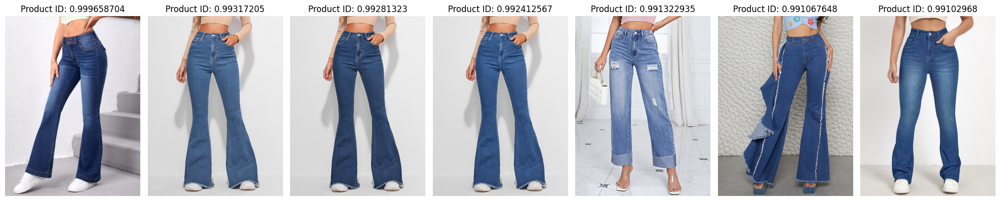

In [32]:
prod_sim("029a823a1e468bd77058d565b59e186a0ad0e446",7)

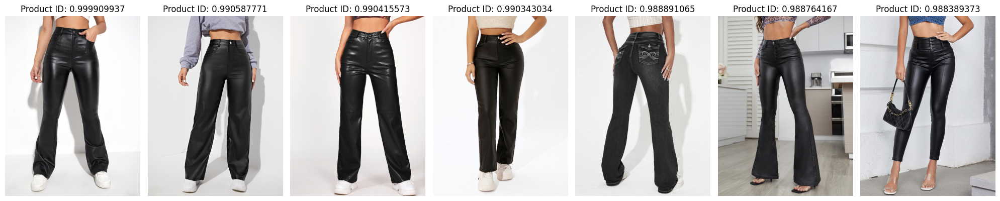

In [37]:
prod_sim("7a8f9f617dbfc54ce051b8736552acd8edb55e74",7)

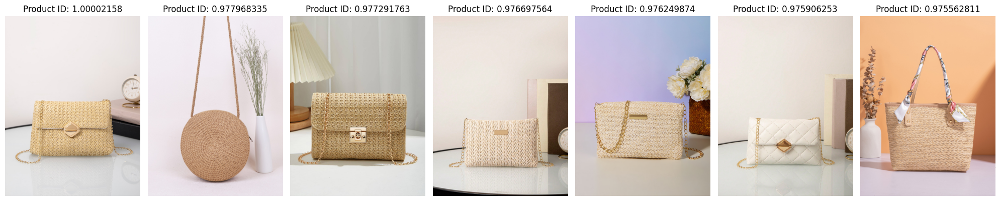

In [34]:
prod_sim("1d30793f95ffe82525d6eb9224ab6fa0531b79c3",7)

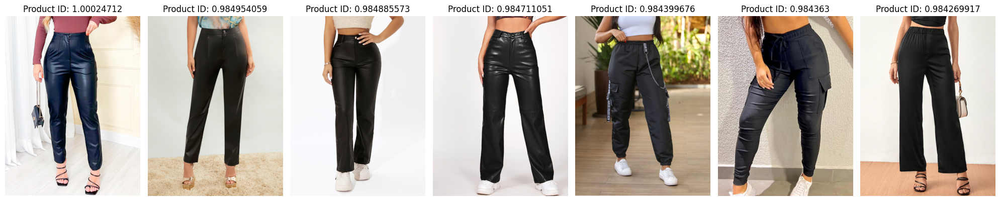

In [67]:
prod_sim("375302635168016fdd8f66e2194a4eab419f4da8",7)

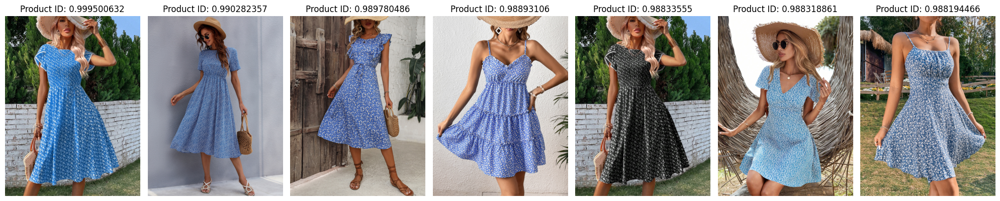

In [41]:
prod_sim("3ff6d5a5e923462dc23355b2ee2dd6fd4dd5561e",7)

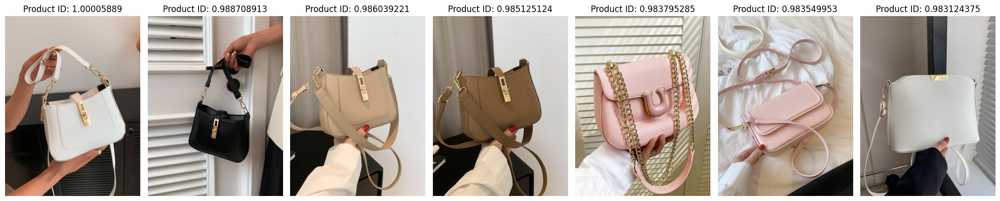

In [42]:
prod_sim("005a9e1cc803b175fe190af7fd55dad3fe037a33",7)

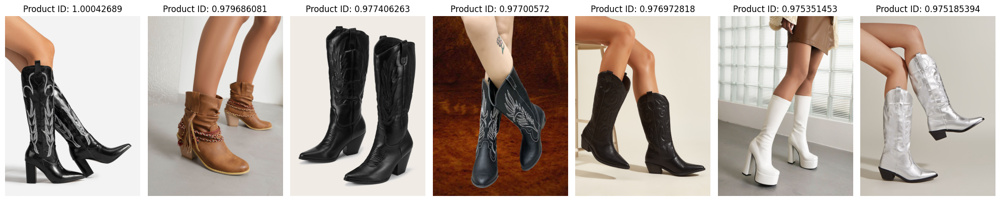

In [57]:
prod_sim("7c167b58e137a70e8d390a3ce8a779490d523706",7)

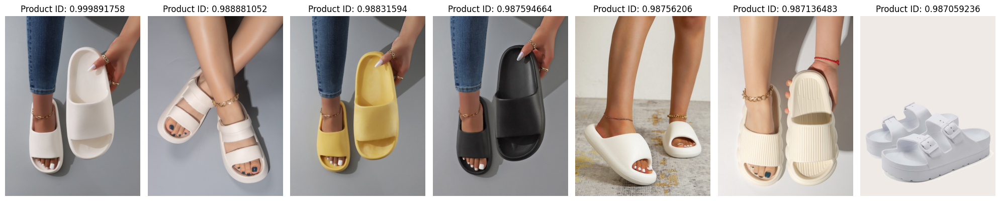

In [59]:
prod_sim("8e711a7a193106f7556ec03fcaff97324b6389fd",7)

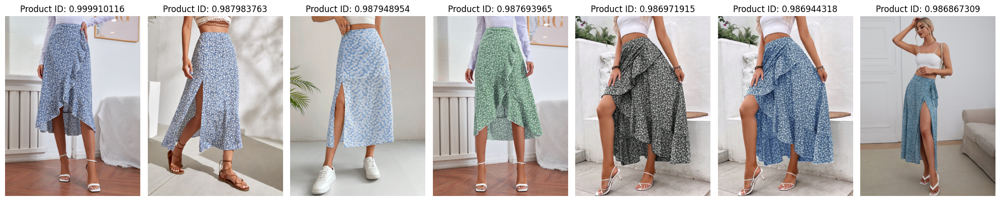

In [68]:
prod_sim("9de283836f75aedae77682452388e1a5299eb222",7)

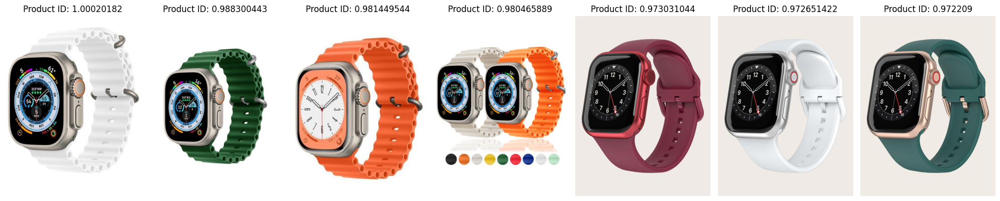

In [72]:
prod_sim("58a115ce093a8f4c9fbff9ff57afe9c46f36c64d",7)

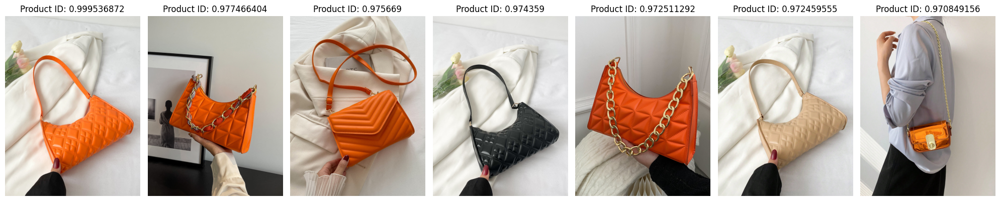

In [73]:
prod_sim("86c380fac08a9fb2a64fec46c802917be66c6753",7)

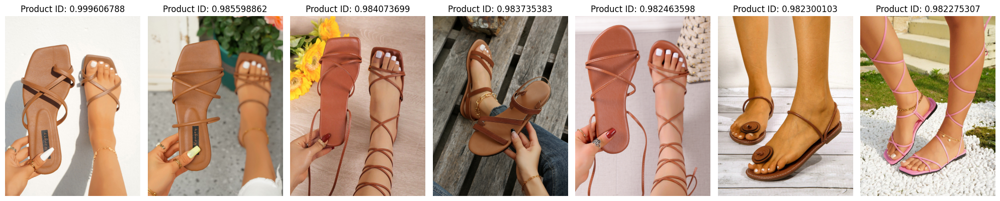

In [74]:
prod_sim("645eb7c38e4937c4e6eb6aa4fda145e56fda8dad",7)

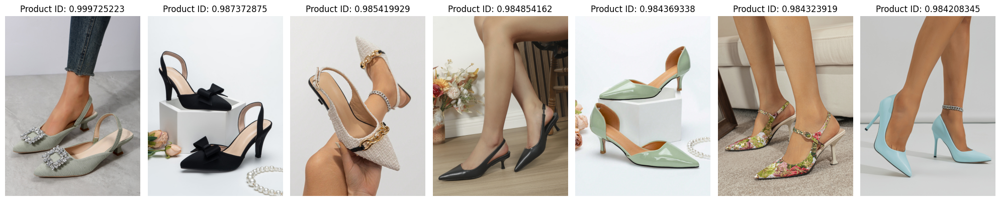

In [78]:
prod_sim("9548325f0ca2e52a19d83073e8097e24498446f4",7)

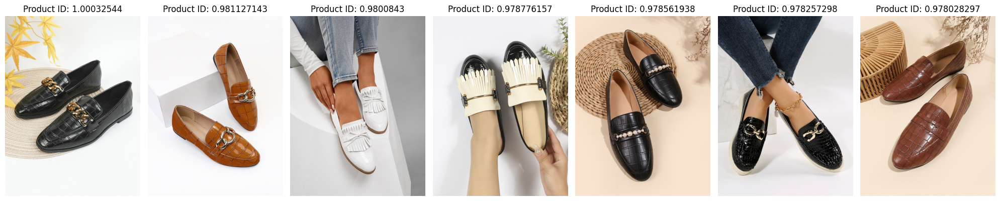

In [80]:
prod_sim("8603f55086743a208870d28fc92a22e30381b6a0",7)

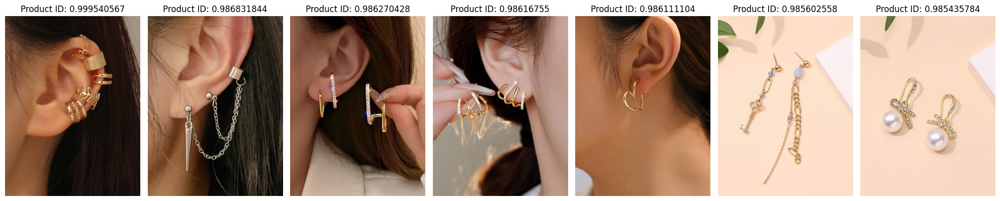

In [81]:
prod_sim("44971cb81ea38b46404674b8a4951729dae5b1c8",7)

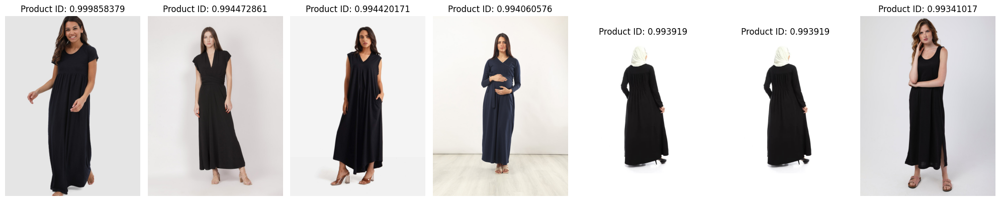

In [89]:
prod_sim("d033b2adb4cae3f867f1b69b2920021dfb87c4a7",7)

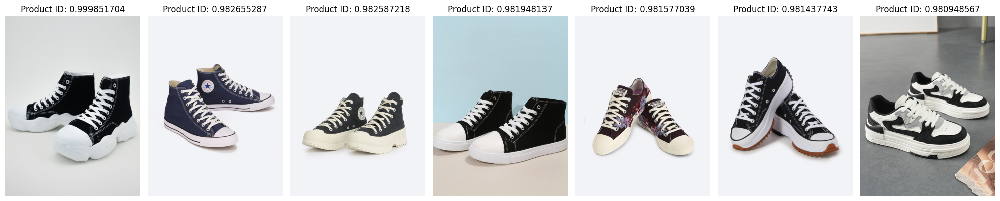

In [90]:
prod_sim("c070eca7f882d70b6c46e549307aeb2be254bbf0",7)

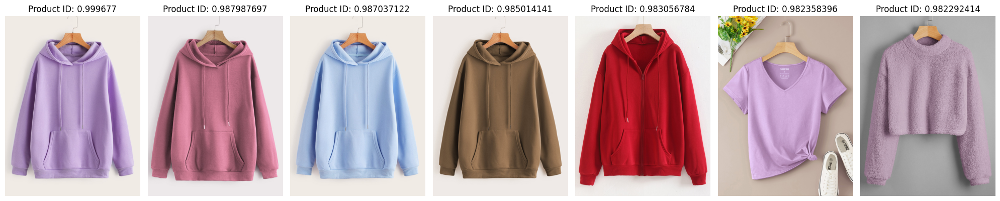

In [91]:
prod_sim("d3b932594cda26711f2b39da156420b3adf2f6fd",7)

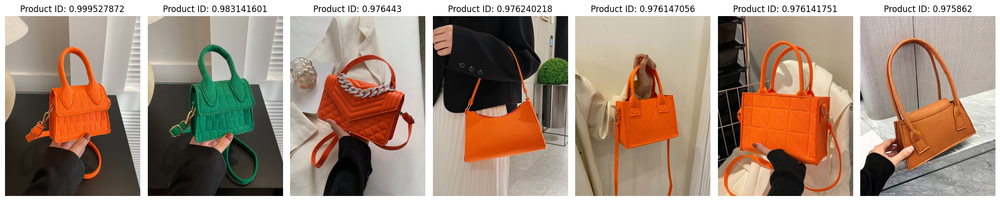

In [94]:
prod_sim("e1a38c27709f43614c4fa79923e5146e6a059d82",7)

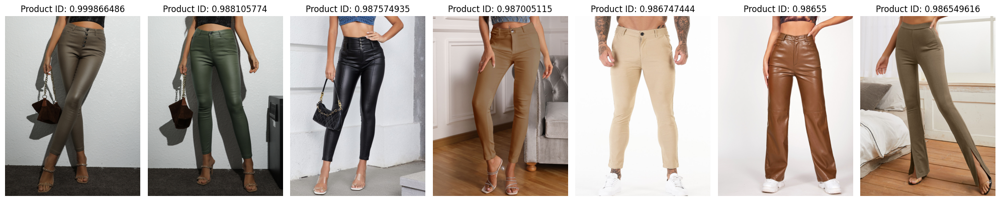

In [98]:
prod_sim("9e0845013e68f7a4f3038a7a898e110ab3d1d58b",7)

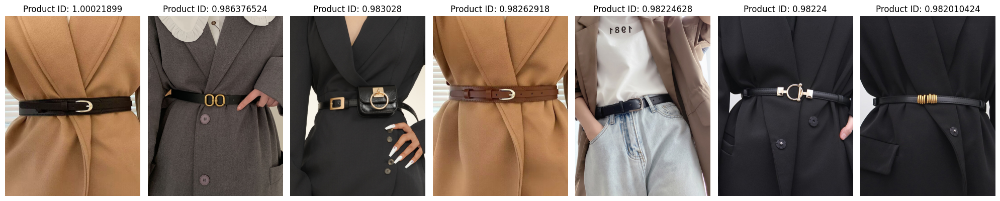

In [99]:
prod_sim("ff22d1a4b414b44b6b4f9afa8a29f786307e37a4",7)

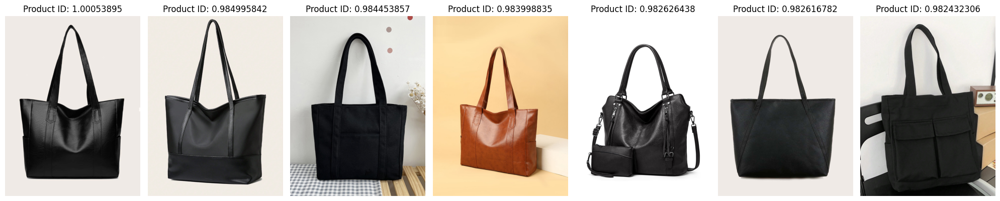

In [100]:
prod_sim("ff2238b8c418b81cc5caaae61e2410216caa28cd",7)

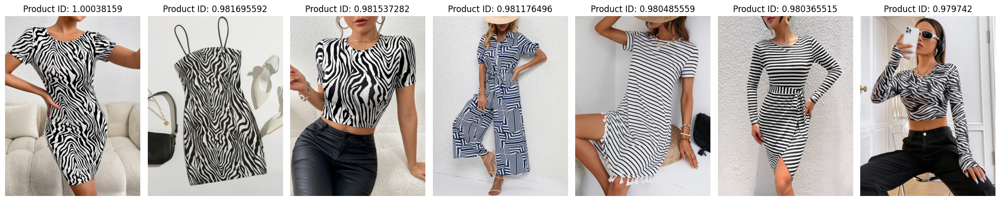

In [102]:
prod_sim("ff14841911670ab34f1b23242ed7a96947437f8c",7)

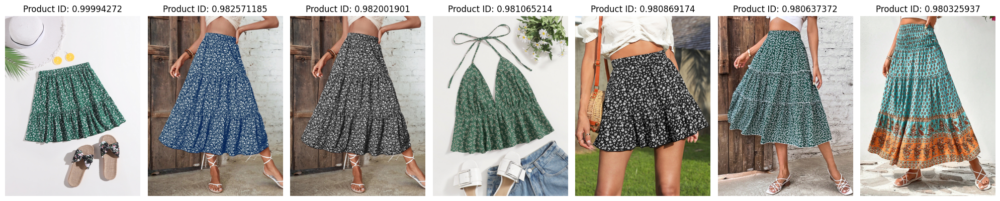

In [103]:
prod_sim("ff1965c356aaa697adce13ab262b6cb4b415b482",7)

In [97]:
# print the similar products of a product
fetch_similar_products("ff5348cc6f77caf4bbbf5bf0d7e33caf12ddee61", k= 7)

[{'product_id': 'ff5348cc6f77caf4bbbf5bf0d7e33caf12ddee61',
  'score': 0.999701142},
 {'product_id': '4201504a42600bfea83c179d6ec04d36d11ccd7a',
  'score': 0.980162203},
 {'product_id': '742bdac36feeacde084704eaa9e11d16967540d4',
  'score': 0.979835391},
 {'product_id': '9e0845013e68f7a4f3038a7a898e110ab3d1d58b',
  'score': 0.979689181},
 {'product_id': '5419a23baddcd2ee7d1f52fea421ed15393dd6fd',
  'score': 0.979402661},
 {'product_id': 'f29fa954fab18aee0745707c281ee05418df6de5',
  'score': 0.979022205},
 {'product_id': '63bb265190ba01c4cd1c92ccbb3efc656d6f344b',
  'score': 0.978970289}]